In [8]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import itertools
import pickle as pk
from scipy.stats import binom


In [29]:
dir = './data/isotopic_draw.pk'
with open(dir, 'rb') as f:
    iso_dict_list= pk.load(f)
fit_file = './data/Isotope_dist_fit.pk'
with open(fit_file, 'rb') as f:
    fit_list= pk.load(f)

In [30]:
dict_exp_list = iso_dict_list[0]
dict_the_list = iso_dict_list[1]

In [31]:
l1 = []
l2 = []
l3 = []
l4 = []
l5 = []
for x in range(100,3000,10):
    y1 = fit_list[0](x)
    y2 = fit_list[1](x)
    y3 = fit_list[2](x)
    y4 = fit_list[3](x)
    y5 = fit_list[4](x)
    l1.append(y1)
    l2.append(y2)
    l3.append(y3)
    l4.append(y4)
    l5.append(y5)

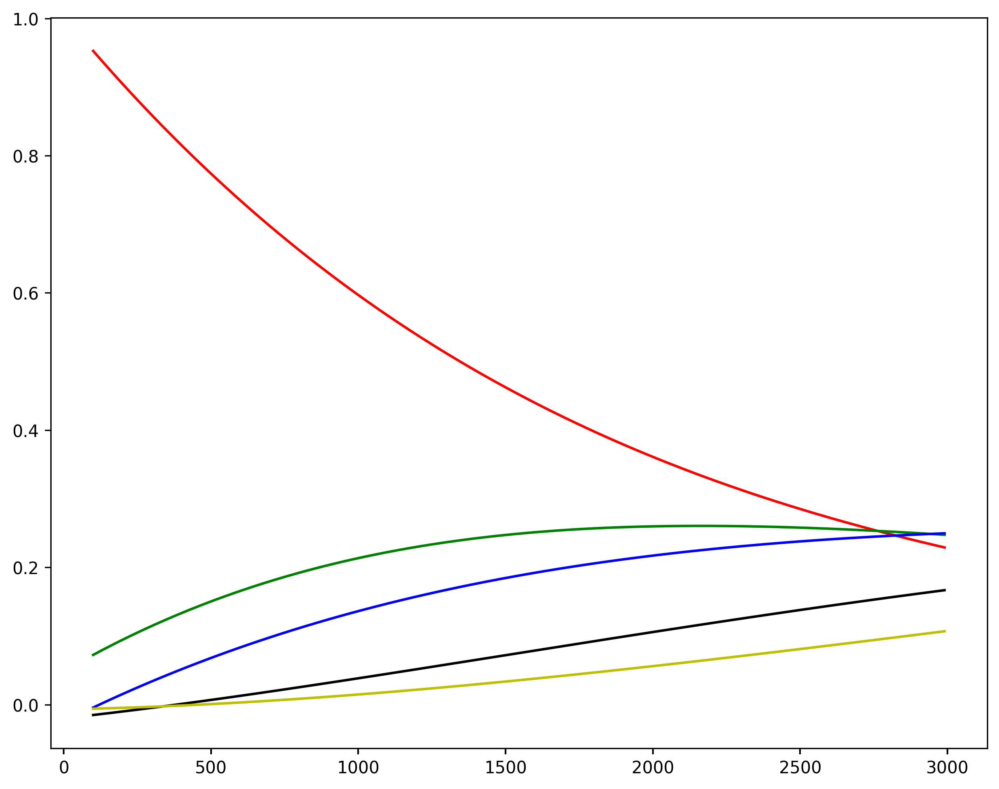

In [32]:
x = range(100,3000,10)

plt.figure(figsize=(10, 8),dpi=300)
# plt.scatter(x, l1, c='r')
plt.plot(x, l1, 'r')
# plt.scatter(x, l2, c='g')
plt.plot(x, l2, 'g')
# plt.scatter(x, l3, c='b')
plt.plot(x, l3, 'b')
# plt.scatter(x, l4, c='k')
plt.plot(x, l4, 'k') 
# plt.scatter(x, l5, c='y')
plt.plot(x, l5, 'y')

plt.show()

In [33]:
iso_list = []
for i in range(len(dict_exp_list)):
    one_exp_dict = dict_exp_list[i]
    one_iso_dict = dict_the_list[i]
    for m in one_exp_dict.keys():
        mz_list = one_exp_dict[m][0]
        exp_int = one_exp_dict[m][1]
        iso_int = one_iso_dict[m][1]
        if exp_int[0] != 0 and iso_int[0] !=0:
            ratio = exp_int[0]/iso_int[0]
        elif exp_int[1]!=0 and iso_int[1] !=0:
            ratio = exp_int[1]/iso_int[1]
        else:
            ratio = exp_int[2]/iso_int[2]
            print(ratio)
            print(mz_list)
            print(exp_int)
            print(iso_int)
        iso_int_array = np.array(iso_int)
        iso_int_array *= ratio
        iso_list.append([mz_list, exp_int, iso_int_array])
        
    

In [34]:
len(iso_list)

539

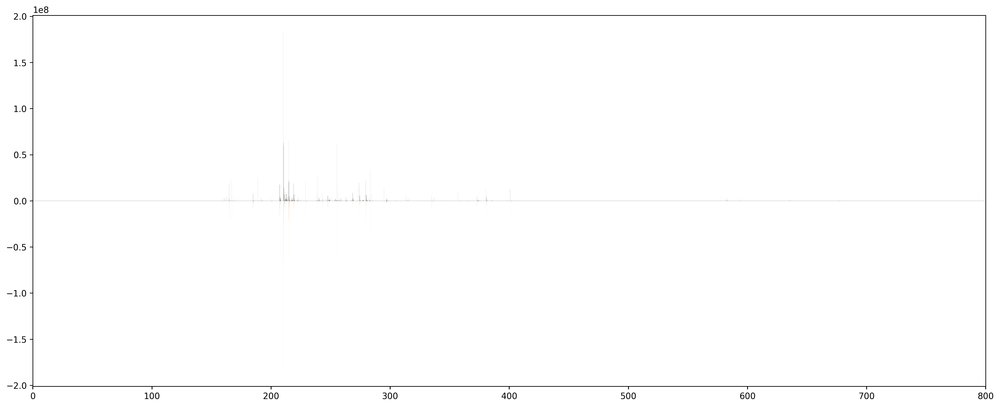

In [35]:
plt.figure(figsize=(20, 8),dpi=300)
plt.plot([0,1000],[0,0], c='k',lw = 0.1)
color = ["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3",
              "#fdb462","#b3de69","#fccde5","#d9d9d9","#bc80bd",
              "#ccebc5","#ffed6f","#fb9a99","#e31a1c","#fdbf6f"]
for i in range(len(iso_list)):
    mz = iso_list[i][0]
    exp = iso_list[i][1]
    the = iso_list[i][2]
    if exp[0]*exp[1]*exp[2]==0:
        continue
    tmp_c = color[i%15]
    for j in range(len(mz)):
        plt.plot([mz[j],mz[j]],[0, exp[j]],c = 'k',lw = 0.03)
        plt.plot([mz[j],mz[j]],[0, -the[j]],c= tmp_c, lw=0.03)
plt.xlim(0,800)
plt.show()



In [36]:
M = [185.15353
,207.52107
,210.18746
,210.5862
,213.78878
,214.58325
,214.58325
,218.39235
,218.97966
,218.97966
,222.19122
,226.58797
,242.99673
,247.49948
,248.49233
,248.49233
,252.99477
,253.49355
,253.98778
,257.98706
,258.49058
,262.98587
,267.97991
,268.48176
,268.48176
,273.9773
,273.9773
,277.03269
,279.47264
,346.31371
,346.31371
,365.63842
,365.63842
,372.96592
,372.96592
,380.29328
,581.93437]

In [18]:
plt.rcParams['xtick.major.width'] = 1

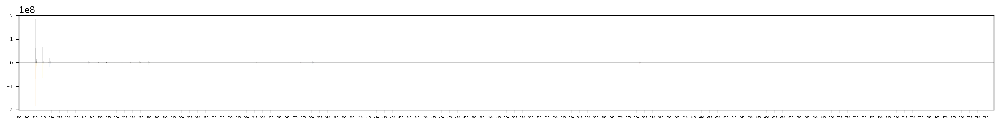

In [29]:
plt.figure(figsize=(20, 2),dpi=300)
# plt.rcParams['xtick.major.size'] = 20
plt.rcParams['xtick.major.width'] = 0.05
# plt.rcParams['xtick.minor.size'] = 10
# plt.rcParams['xtick.minor.width'] = 0.1
count = 0
plt.plot([0,1000],[0,0], c='k',lw = 0.1)

color = ["#8dd3c7","#ffffb3","#bebada","#fb8072","#80b1d3",
              "#fdb462","#b3de69","#fccde5","#d9d9d9","#bc80bd",
              "#ccebc5","#ffed6f","#fb9a99","#e31a1c","#fdbf6f"]
for i in range(len(iso_list)):
    mz = iso_list[i][0]
    exp = iso_list[i][1]
    the = iso_list[i][2]
    if exp[0]*exp[1]*exp[2]==0:
        continue
    if mz[0] not in M:
        # print(mz[0])
        continue
    tmp_c = color[i%15]
    # print(count)
    count += 1
    for j in range(len(mz)):
        plt.plot([mz[j],mz[j]],[0, exp[j]],c = 'k',lw = 0.05)
        plt.plot([mz[j],mz[j]],[0, -the[j]],c= tmp_c, lw=0.05)
plt.xlim(200,800)
plt.xticks(range(200,800,5), fontsize=3)
plt.yticks(fontsize=5)
plt.show()

In [12]:
def get_KL(v1, v2, is_P=0):
    if is_P == 0:
        v1 = np.array(v1)
        v2 = np.array(v2)
        p_v1 = v1 / sum(v1)
        p_v2 = v2 / sum(v2)
    else:
        p_v1 = v1
        p_v2 = v2
    KL = 0
    for i in range(len(v1)):
        if p_v1[i] > 0 and p_v2[i] > 0:
            KL += p_v1[i] * np.log2(p_v1[i] / p_v2[i])
    return KL


def get_JS(v1, v2, w1=0.5, w2=0.5):
    v1 = np.array(v1)
    v2 = np.array(v2)

    p_v1 = v1 / sum(v1)
    p_v2 = v2 / sum(v2)
    p_avg = (p_v1 + p_v2) / 2
    JS = w1 * get_KL(p_v1, p_avg, 1) + w2 * get_KL(p_v2, p_avg, 1)
    return JS


In [39]:
count=0
fig, axs = plt.subplots(8,5,figsize=(30, 30),dpi=300)
for i in range(len(iso_list)):
    mz = iso_list[i][0]
    exp = iso_list[i][1]
    the = iso_list[i][2]
    if exp[0]*exp[1]*exp[2]==0:
        continue
    if mz[0] not in M:
        continue
    # print(count)
    a1 = count//5
    a2 = count%5
    # axs[a1,a2].plot([0,1000],[0,0], c='k',lw = 0.1)
    for j in range(len(mz)):
        axs[a1,a2].plot([mz[j],mz[j]],[0, exp[j]],c = 'b',lw = 1)
        axs[a1,a2].plot([mz[j],mz[j]],[0, -the[j]],c= 'r', lw=1)
    tmp_JS = np.round(get_JS(exp,the),5)
    axs[a1,a2].set_title(str(mz[0])+'_JS:'+str(tmp_JS))
    axs[a1,a2].plot([mz[0]-0.1,mz[4]+0.1],[0,0], c='k',lw=1)
    count += 1
    sns.despine()
plt.tight_layout(pad=2) 
plt.show()   


In [120]:
B_dp4 = pd.read_csv('./data/F12_Blank_merged.csv')
B_dp4.columns = ['mz','Int','Int_R']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4

,mz,Int,Int_R,group
0,150.02987,59034.38129,0.005111,15
1,150.06621,102093.76170,0.008839,15
2,150.32746,11900.66394,0.001030,15
3,150.47771,113477.70130,0.009825,15
4,150.48519,160594.65110,0.013904,15
...,...,...,...,...
2265,1316.66113,26776.86523,0.002318,131
2266,1352.75021,24418.38989,0.002114,135
2267,1444.02530,25633.80029,0.002219,144
2268,1499.40320,21871.73950,0.001894,149


In [104]:
plt.figure(figsize=(50,20),dpi=300)
df = B_dp4
plt.plot(df['mz'],df['Int'])
plt.xlim(150,600)
plt.show()

In [86]:
plt.figure(figsize=(50, 20),dpi=300)
df = B_dp4
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
plt.ylim(0,300000)
# plt.xlim(0,30)
plt.show()


In [106]:
B_dp4 = pd.read_csv('./data/F12_Blank_orginal_peak.csv')
B_dp4.columns = ['mz','Int']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4

,mz,Int,group
0,148.5118,0.0,14
1,148.5122,0.0,14
2,148.5127,0.0,14
3,148.5131,0.0,14
4,150.0264,0.0,15
...,...,...,...
32585,1855.3310,0.0,185
32586,2020.1724,0.0,202
32587,2020.1939,0.0,202
32588,2020.2154,0.0,202


In [107]:
plt.figure(figsize=(50,20),dpi=300)
df = B_dp4
plt.plot(df['mz'],df['Int'])
plt.xlim(150,600)
plt.show()

In [94]:
plt.figure(figsize=(50, 20),dpi=300)
df = B_dp4
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
plt.ylim(0,20000)
# plt.xlim(0,30)
plt.show()

In [87]:
B_dp4 = pd.read_csv('./data/F12_B_merged_0.5.csv')
B_dp4.columns = ['mz','Int','Int_R']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4

,mz,Int,Int_R,group
0,150.06612,1.316708e+05,0.002097,15
1,150.47749,6.148961e+04,0.000980,15
2,150.48535,7.141664e+04,0.001138,15
3,150.96122,2.692360e+06,0.042889,15
4,150.96935,4.743778e+05,0.007557,15
...,...,...,...,...
1537,1408.44085,8.122026e+04,0.001294,140
1538,1414.67148,1.081427e+05,0.001723,141
1539,1519.31698,8.538357e+04,0.001360,151
1540,1658.97358,8.392684e+04,0.001337,165


In [90]:
plt.figure(figsize=(50, 20),dpi=300)
df = B_dp4
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
plt.ylim(0,1600000)
# plt.xlim(0,30)
plt.show()

In [96]:
B_dp4 = pd.read_csv('./data/F12_merged.csv')
B_dp4.columns = ['mz','Int','Int_R']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4

,mz,Int,Int_R,group
0,150.47728,3.018885e+05,0.001652,15
1,150.96109,1.865657e+06,0.010208,15
2,150.96921,1.426000e+05,0.000780,15
3,150.98735,1.508382e+05,0.000825,15
4,151.03852,4.513850e+05,0.002470,15
...,...,...,...,...
1274,1170.80594,1.101242e+05,0.000603,117
1275,1233.69371,1.176548e+05,0.000644,123
1276,1253.33673,1.139866e+05,0.000624,125
1277,1448.68355,1.384224e+05,0.000757,144


In [100]:
plt.figure(figsize=(50, 20),dpi=300)
df = B_dp4
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
plt.ylim(0,3600000)
# plt.xlim(0,30)
plt.show()

In [101]:
plt.figure(figsize=(50, 20),dpi=300)
df = B_dp4
sns.violinplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
plt.ylim(0,3600000)
# plt.xlim(0,30)
plt.show()

In [152]:
def get_mean_of_win(sp_df, win=1, step=0.5):
    sp_df['key1'] = sp_df['mz']//win
    sp_df['key2'] = (sp_df['mz']+0.5)//win -step
    dict_mean = {}
    for x in sp_df['key1'].unique():
        m = np.mean(sp_df[sp_df['key1']==x]['Int'])
        dict_mean[x]=m
    for x in sp_df['key2'].unique():
        m = np.mean(sp_df[sp_df['key2']==x]['Int'])
        dict_mean[x]=m
    return sp_df,dict_mean
def find_min_mean(dict_mean, start, win=5):
    min_mean = -1
    for i in np.arange(start-win/2, start+win/2+0.1, 0.5 ):
        if i in dict_mean.keys():
            tmp = dict_mean[i]
            if min_mean <0 or tmp< min_mean:
                min_mean = tmp
    if min_mean < 0:
        min_mean = 0
    return min_mean
def label_noise(sp_df, dict_mean, win=5):
    noise_th = []
    sp_df['noise'] =0
    for x in sp_df['key1'].unique():
        th = find_min_mean(dict_mean,x)
        noise_th.append([x, th])
        sp_df.loc[sp_df[sp_df['key1']==x][sp_df['Int']<=th].index.tolist(),'noise']=1
    return sp_df, np.array(noise_th)

In [142]:
df=B_dp4
df_B, dict_mean = get_mean_of_win(df)
df_B, noise_th = label_noise(df_B, dict_mean)
df_noise = df_B[df_B['noise']==1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [150]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_B
sns.boxplot(x='group',y='Int',data=df,showfliers=False,hue='noise')
sns.stripplot(x='group',y='Int',data=df,color='.25',hue='noise',dodge=True)
sns.despine()
plt.ylim(0,300000)
# plt.xlim(0,30)
plt.show()

In [155]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_noise
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
# plt.xlim(0,30)
plt.show()

In [156]:
plt.figure(figsize=(50, 20),dpi=300)
df = noise_th
plt.plot(df[:,0],df[:,1])
sns.despine()
# plt.xlim(0,30)
plt.show()

In [157]:
B_dp4 = pd.read_csv('./data/F12_merged.csv')
B_dp4.columns = ['mz','Int','Int_R']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4


,mz,Int,Int_R,group
0,150.47728,3.018885e+05,0.001652,15
1,150.96109,1.865657e+06,0.010208,15
2,150.96921,1.426000e+05,0.000780,15
3,150.98735,1.508382e+05,0.000825,15
4,151.03852,4.513850e+05,0.002470,15
...,...,...,...,...
1274,1170.80594,1.101242e+05,0.000603,117
1275,1233.69371,1.176548e+05,0.000644,123
1276,1253.33673,1.139866e+05,0.000624,125
1277,1448.68355,1.384224e+05,0.000757,144


In [165]:
df=B_dp4
df_B, dict_mean = get_mean_of_win(df)
df_B, noise_th = label_noise(df_B, dict_mean)
df_noise = df_B[df_B['noise']==1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [161]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_B
sns.boxplot(x='group',y='Int',data=df,showfliers=False,hue='noise')
sns.stripplot(x='group',y='Int',data=df,color='.25',hue='noise',dodge=True)
sns.despine()
plt.ylim(0,3600000)
# plt.xlim(0,30)
plt.show()

In [162]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_noise
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
# plt.xlim(0,30)
plt.show()

In [167]:
df_B.to_csv('./data/test_filter_F12_merged.csv',index=None)

In [168]:
B_dp4 = pd.read_csv('./data/F12_Blank_orginal_peak.csv')
B_dp4.columns = ['mz','Int']
B_dp4['group'] = (B_dp4['mz']//10).astype('int')
B_dp4

,mz,Int,group
0,148.5118,0.0,14
1,148.5122,0.0,14
2,148.5127,0.0,14
3,148.5131,0.0,14
4,150.0264,0.0,15
...,...,...,...
32585,1855.3310,0.0,185
32586,2020.1724,0.0,202
32587,2020.1939,0.0,202
32588,2020.2154,0.0,202


In [169]:
df=B_dp4
df_B, dict_mean = get_mean_of_win(df)
df_B, noise_th = label_noise(df_B, dict_mean)
df_noise = df_B[df_B['noise']==1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [170]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_B
sns.boxplot(x='group',y='Int',data=df,showfliers=False,hue='noise')
sns.stripplot(x='group',y='Int',data=df,color='.25',hue='noise',dodge=True)
sns.despine()
plt.ylim(0,20000)
# plt.xlim(0,30)
plt.show()

In [171]:
plt.figure(figsize=(50, 20),dpi=300)
df = df_noise
sns.boxplot(x='group',y='Int',data=df,showfliers=False)
sns.stripplot(x='group',y='Int',data=df,color='.25')
sns.despine()
# plt.xlim(0,30)
plt.show()

In [173]:
df_B

,mz,Int,group,key1,key2,noise
0,148.5118,0.0,14,148.0,148.5,1
1,148.5122,0.0,14,148.0,148.5,1
2,148.5127,0.0,14,148.0,148.5,1
3,148.5131,0.0,14,148.0,148.5,1
4,150.0264,0.0,15,150.0,149.5,1
...,...,...,...,...,...,...
32585,1855.3310,0.0,185,1855.0,1854.5,1
32586,2020.1724,0.0,202,2020.0,2019.5,1
32587,2020.1939,0.0,202,2020.0,2019.5,1
32588,2020.2154,0.0,202,2020.0,2019.5,1


## Annotation

In [67]:
an_01 = pd.read_csv('data/annotate_0.01.csv')
an_01

,mz,exp_int,the_int,annotation,HNas
0,152.990494,0.1033,0.000000,[],[]
1,164.664200,9.4419,7.852981,"[(7, 0)]","[[6, 0]]"
2,164.993607,0.0590,0.000000,[],[]
3,164.997498,1.1435,2.299378,"[(7, 0)]","[[6, 0]]"
4,165.330704,0.3849,0.298075,"[(7, 0)]","[[6, 0]]"
...,...,...,...,...,...
187,582.954285,0.8902,0.604450,"[(28, 20)]","[[7, 5]]"
188,583.455383,0.2041,0.172581,"[(28, 20)]","[[7, 5]]"
189,615.942505,0.0790,0.000000,[],[]
190,998.089111,0.0731,0.000000,[],[]


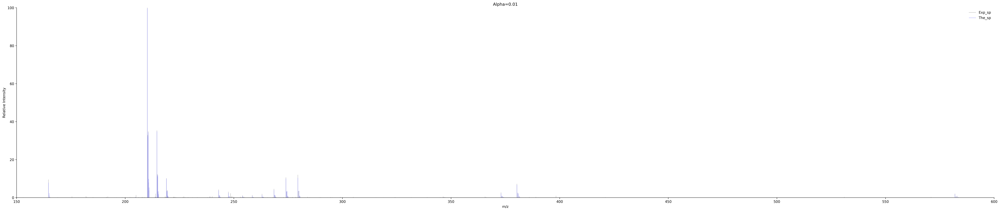

In [69]:
plt.figure(figsize=(50,10),dpi=300)
lw1 = 0.5
lw2 = 0.3
for i in range(an_01.shape[0]):
    x = an_01.loc[i,'mz']
    y1 = an_01.loc[i,'exp_int']
    y2 = an_01.loc[i,'the_int']
    plt.plot([x,x],[0,y1], lw=lw1, c='grey', zorder=1)
    plt.plot([x,x],[0,y2], lw=lw2, c='b', zorder=2)
sns.despine()
plt.plot([0,0],[0,0],lw=lw1, c='grey',label='Exp_sp')
plt.plot([0,0],[0,0],lw=lw2, c='b',label='The_sp')

plt.xlim(150,600)
plt.ylim(0,100)
plt.xlabel('m/z')
plt.ylabel('Relative Intensity')
plt.legend(frameon=False)
plt.title('Alpha='+str(0.01))
plt.show()



In [45]:
an_01.loc[i,'mz']

1080.0147705078123

In [14]:
# a =[151022080,7767030,749970]
# b = [0,1,2]
# a =[51585785,17075729,5265210,425955]
# b = [1,2,3,4]
# a = [1819451,21427861,10684691,4067071]
# b = [2,3,4,5]
n = 7

In [15]:
p = np.dot(a,b)/(np.sum(a)*n)
p

0.4924804370608761

0.011617178687504027

In [3]:
from scipy.stats import binom

In [36]:
n = 5
# a = [1819451,21427861,10684691,4067071] 
# b = [2,3,4,5]
# a =[51585785,17075729,5265210,425955]
# b = [1,2,3,4]
a =[151022080,7767030,749970]
b = [0,1,2]

In [37]:
thi = []
N = np.sum(a)*n
p = np.dot(a,b)/N
for x in b:
    tmpi = binom.pmf(x,n,p) * (N/n)
    print(binom.pmf(x,n,p))
    thi.append(tmpi)
print (thi)


0.9432481074172295
0.055433388633589986
0.0013030974782728723
[150484935.26908597, 8843791.823885404, 207894.97283397402]


In [38]:
p

0.011617178687504027

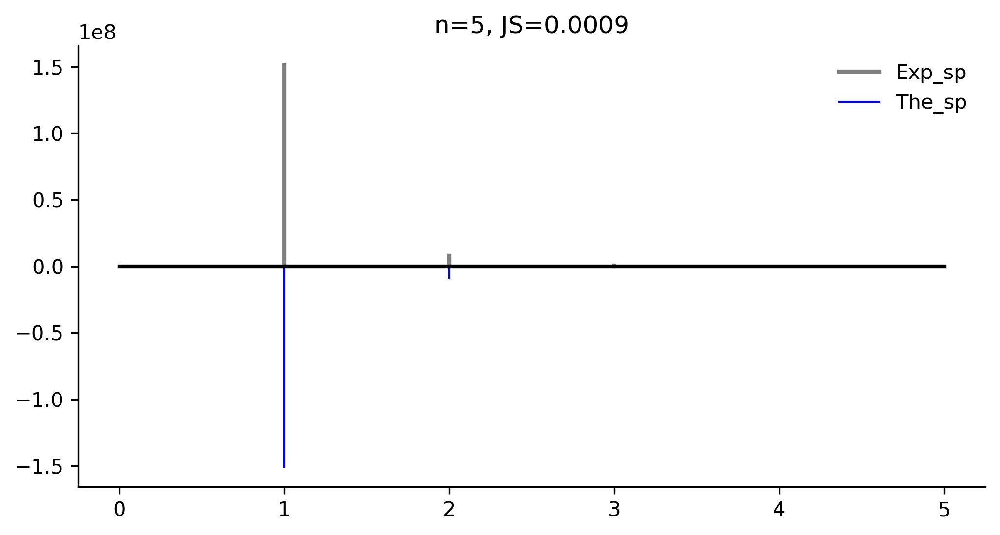

In [41]:
plt.figure(figsize=(8,4),dpi=300)
lw1 = 2
lw2 = 1
tmp_JS = np.round(get_JS(a,thi),5)
for i in range(len(a)):
    x = i+1
    y1 = a[i]
    y2 = thi[i]
    plt.plot([x,x],[0,y1], lw=lw1, c='grey', zorder=1)
    plt.plot([x,x],[0,-y2], lw=lw2, c='b', zorder=2)
sns.despine()
plt.plot([0,5],[0,0],lw =2, c = 'k')
plt.plot([0,0],[0,0],lw=lw1, c='grey',label='Exp_sp')
plt.plot([0,0],[0,0],lw=lw2, c='b',label='The_sp')
plt.title('n='+str(n)+', JS='+str(tmp_JS))
plt.legend(frameon =False)
plt.show()


In [34]:
y34  = pd.read_csv('./result/Y34_2.csv')
y34

,Int,H,Na
0,2518708,10,4
1,2116718,10,5
2,1647736,10,6
3,854922,10,7
4,9927981,9,3
5,6380645,9,4
6,2870397,9,5
7,11891681,8,2
8,5995056,8,3
9,2392328,8,4


In [50]:
n = 7
a = np.array(y34[y34.H==n]['Int'])
b = np.array(y34[y34.H==n]['Na'])

In [51]:
a

array([ 414016, 7077302, 2525250])

In [52]:
thi = []
N = np.sum(a)*n
p = np.dot(a,b)/N
for x in b:
    tmpi = binom.pmf(x,n,p) * (N/n)
    print(binom.pmf(x,n,p))
    thi.append(tmpi)
print (thi)
p = np.round(p, 4)

0.26464101147965235
0.38743410886044904
0.2430870211729364
[2650794.6870747185, 3880760.0969200903, 2434897.677496157]


In [53]:
p

0.173

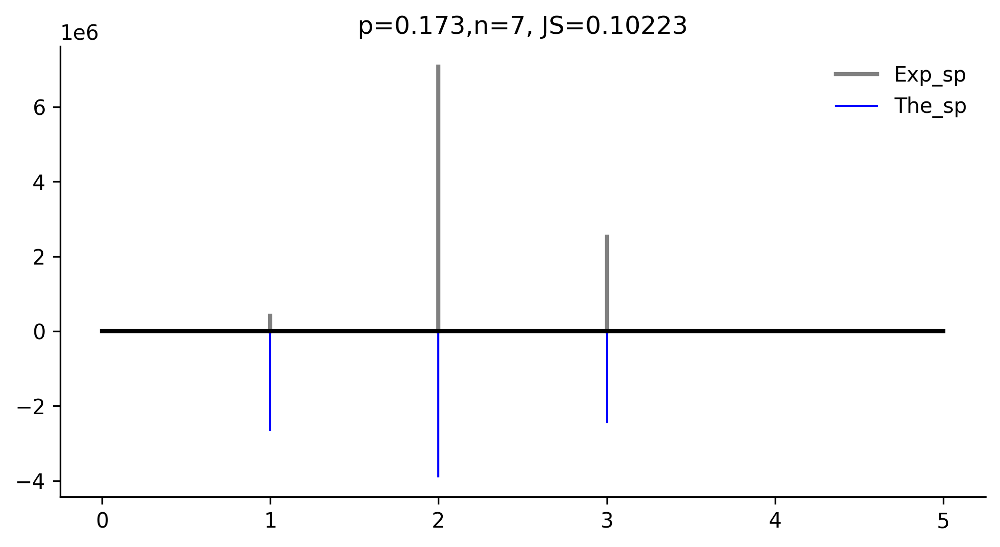

In [54]:
plt.figure(figsize=(8,4),dpi=300)
lw1 = 2
lw2 = 1
tmp_JS = np.round(get_JS(a,thi),5)
for i in range(len(a)):
    x = i+1
    y1 = a[i]
    y2 = thi[i]
    plt.plot([x,x],[0,y1], lw=lw1, c='grey', zorder=1)
    plt.plot([x,x],[0,-y2], lw=lw2, c='b', zorder=2)
sns.despine()
plt.plot([0,5],[0,0],lw =2, c = 'k')
plt.plot([0,0],[0,0],lw=lw1, c='grey',label='Exp_sp')
plt.plot([0,0],[0,0],lw=lw2, c='b',label='The_sp')
plt.title('p='+str(p)+',n='+str(n)+', JS='+str(tmp_JS))
plt.legend(frameon =False)
plt.show()